# Simple Flattened Pixelwise T2 analysis
To do a simple flattened pixelwise analysis I determined that the below steps are needed:
1. Import segmentation, FSPGR, T2 data
2. Make segmentation in the same space as the FSPGR - problem because of the transformed images from QMetrics. 
3. Downsample segmentation & FSPGR to T2 resolution/space 
    I decided to do it this way because I feel that it is more appropriate to downsample the FSPGR image to fit the T2 data than to make data up when upsampling the T2
4. Calculate T2 map for the T2 image
5. Extract T2 values from cartilage regions of interest (tibia) 
6. Find the Mean/SD T2 values along the desired direction (vertical for the tibia)
7. Do desired statistics once there are mean/sd maps for each participant


# Step 1 import data

In [1]:
import os
import glob
import SimpleITK as sitk
import numpy 
import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
locationFSPGR = '/Users/gattia/Dropbox/Elora-images/Data_from_IRC_and_original_matlab_t2Maps/exam_3655/Ser7/'
locationT2 = '/Users/gattia/Dropbox/Elora-images/Data_from_IRC_and_original_matlab_t2Maps/exam_3655/Ser8/'
locationSegmentation = '/Users/gattia/Dropbox/Elora-images/extracted_main_segmentations/'
segmentationName = '3655_boneSeg.nrrd'

In [3]:
def readImageSeries(folder):
    reader = sitk.ImageSeriesReader()
    dicom_names = reader.GetGDCMSeriesFileNames(folder)
    reader.SetFileNames(dicom_names)
    image = reader.Execute()
    return(image)

In [4]:
fspgrImage = readImageSeries(locationFSPGR)
t2Image = readImageSeries(locationT2)
segmentation = sitk.ReadImage(locationSegmentation+segmentationName)


# Print out some of the image parameters

In [5]:
print('FSPGR Spacing:     ' + str(fspgrImage.GetSpacing()))
print('FSPGR Origin:      ' + str(fspgrImage.GetOrigin()))
print('FSPGR Shape:       ' + str(fspgrImage.GetSize()))
print('T2 Spacing:        ' + str(t2Image.GetSpacing()))
print('T2 Origin:         ' + str(t2Image.GetOrigin()))
print('T2 Shape:          ' + str(t2Image.GetSize()))
print('Seg Spacing:       ' + str(segmentation.GetSpacing()))
print('Seg Origin:        ' + str(segmentation.GetOrigin()))
print('Seg Shape:         ' + str(segmentation.GetSize()))

print('Origin Difference: ' + str(numpy.asarray(fspgrImage.GetOrigin())-numpy.asarray(t2Image.GetOrigin())))



FSPGR Spacing:     (0.3125, 0.3125, 0.9999811053276062)
FSPGR Origin:      (-28.51580047607422, -103.57499694824219, 56.35459899902344)
FSPGR Shape:       (512, 512, 94)
T2 Spacing:        (0.625, 0.625, 1.0)
T2 Origin:         (-29.036399841308594, -103.42900085449219, 56.275699615478516)
T2 Shape:          (256, 256, 192)
Seg Spacing:       (1.0000039999999997, 0.3125, 0.31249999999999994)
Seg Origin:        (-144.66674800000004, -102.86925099999999, -88.36763499999998)
Seg Shape:         (94, 512, 512)
Origin Difference: [ 0.52059937 -0.14599609  0.07889938]


# Step 2 make segmentation in same space as fspgr

# Print out informaton about the rotaton matrices for the Segmentation & FSPGR images..... 
This information will be important for determining how we need to flip/rotate the Segmentation to make it align with the FSPGR image. 

In [6]:
segmentationRotationMatrix = numpy.asarray(segmentation.GetDirection())
segmentationRotationMatrix = numpy.matrix(numpy.reshape(segmentationRotationMatrix, (3,3)))
fspgrRotationMatrix = numpy.asarray(fspgrImage.GetDirection())
fspgrRotationMatrix = numpy.matrix(numpy.reshape(fspgrRotationMatrix, (3,3)))
print('Segmentation Rotation Matrix')
print(segmentationRotationMatrix)
print('FSPGR Rotation Matrix')
print(fspgrRotationMatrix)


Segmentation Rotation Matrix
[[ 0.98922425 -0.02183399  0.14477107]
 [ 0.02484315  0.99951059 -0.01901027]
 [-0.14428515  0.02240199  0.98928254]]
FSPGR Rotation Matrix
[[-0.02183431 -0.14477206 -0.9892241 ]
 [ 0.99951059  0.01901001 -0.02484345]
 [ 0.02240179 -0.9892824   0.14428614]]


We see above that the segmentation is essentially aligned with the x/y/z axes as the diagnal is essentially ones with the rest essentially being zeros. The FSPGR values are essentially identical #s, but they are in different places. 

If we think about it like unit vectors (I'll call them ijk for corresponding xyz to differentiate). The i unit vector has been transformed to be purely in the y direction, the j unit vector has been transformed to be in  z direction, and the k unit vector has been transformed to be in the x direction. 

So, we could reshape this data by doing a for loop and just placing each i/j/k as we think it "should" be. But I hate loops. So, I'll do it a slightly different way. 

rotationMatrixSegmentation * transformationMatrix = rotationMatrixFSPGR

transformationMatrix = rotationMatrixFSPGR * rotationMatrixSegmentation-1

In [7]:
transformationMatrix = numpy.matmul(segmentationRotationMatrix.I, fspgrRotationMatrix)

In [8]:
print('The transformation matrix is: ')
print(transformationMatrix)
print('The Segmentation matrix after being rotated is: ')
print(numpy.matmul(segmentationRotationMatrix, transformationMatrix))

The transformation matrix is: 
[[ -2.82338741e-07  -1.00406713e-06  -1.00000000e+00]
 [  1.00000000e+00  -2.39406000e-07  -2.82338501e-07]
 [ -2.39405717e-07  -1.00000000e+00   1.00406720e-06]]
The Segmentation matrix after being rotated is: 
[[-0.02183431 -0.14477206 -0.9892241 ]
 [ 0.99951059  0.01901001 -0.02484345]
 [ 0.02240179 -0.9892824   0.14428614]]


#### Transformation matrix
The above tells us what was explained in words above. If you look at the "transformation matrix" it shows in what direction each axis "should" be in to make them align. 

#### Numpy/SITK
This is probably a good place to say that the above stuff is giving us data about the sitk (simpleITK) "images" and that the axes are not the same between numpy and sitk. 

```
sitk = x,y,z
numpy = z,y,x
```

So. For the above segmentation and fspgr images the order of axes in sitk & numpy are: 

||SITK|NUMPY|
|-|
|Segmentation | x,y,z|z,y,x|
|FSPGR        | y,z,x|x,z,y|

To make the Segmentation Array align with the FSPGR array we simply need to move the z/y/x dimensions to be the same as in the FSPGR example just below it. So, looking at them in order of how they are presnted under numpy for Segmentation, z needs to be second, y needs to be last, and x needs to be first. You can re-order dimensions in numpy using ```numpy.transpose```. The new order will be (2,0,1). 

In [9]:
segmentationArray = sitk.GetArrayFromImage(segmentation)
fspgrArray = sitk.GetArrayFromImage(fspgrImage)
t2Array = sitk.GetArrayFromImage(t2Image)
segmentationArray_rotated = numpy.transpose(segmentationArray,(2,0,1))

In [10]:
print('Segmentation Array Shape:         ' + str(segmentationArray.shape))
print('Rotated Segmentation Array Shape: ' + str(segmentationArray_rotated.shape))
print('FSPGR Array Shape:                ' + str(fspgrArray.shape))

Segmentation Array Shape:         (512, 512, 94)
Rotated Segmentation Array Shape: (94, 512, 512)
FSPGR Array Shape:                (94, 512, 512)


### Here is a visualization of the FSPGR array data and the newly rotated Segmentation array data

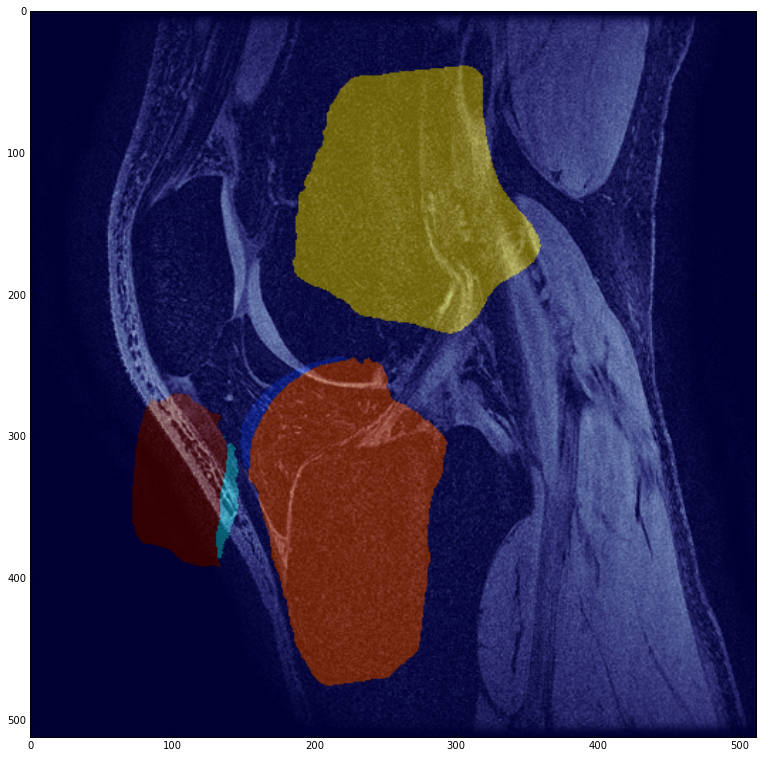

In [11]:
slice = 50
plt.figure(figsize=(13,13))
plt.imshow(fspgrArray[slice, :,:], cmap='bone')
plt.imshow(segmentationArray_rotated[slice,:,:], alpha=0.4)

This still doenst look quite right! Haha. That's because if you look at the transformation matrix from above there were a few negative signs in there that we didnt take into account with the transpose. So, now we'll use the flip function to fix that part. 

In [12]:
segmentationArray_rotated_flipped = numpy.fliplr(numpy.flipud(segmentationArray_rotated))

### Below looks much better
You can change the "slice" value below and re-run the cell to see different slices and how they look

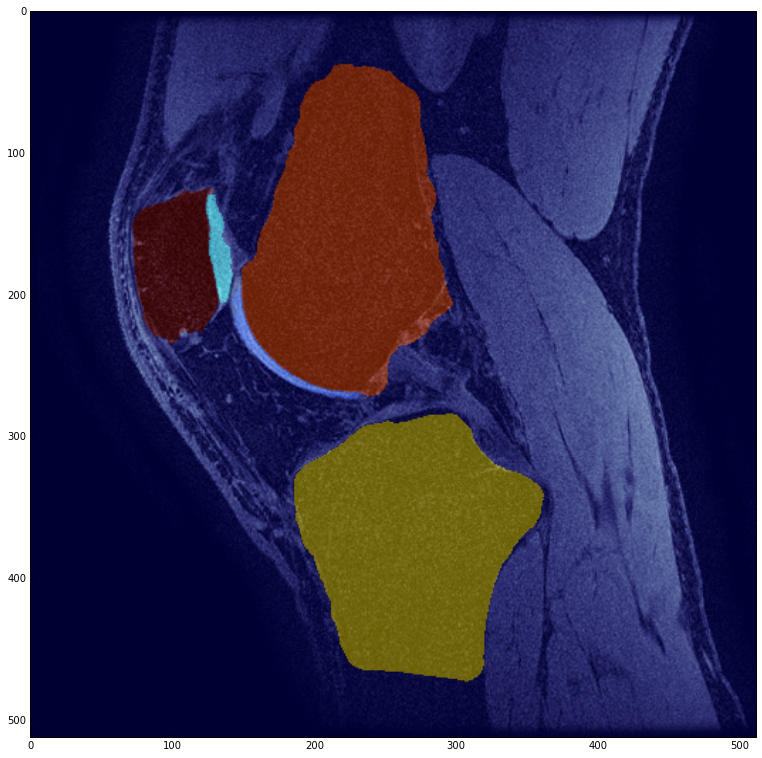

In [13]:
slice = 40
plt.figure(figsize=(13,13))
plt.imshow(fspgrArray[slice, :,:], cmap='bone')
plt.imshow(segmentationArray_rotated_flipped[slice,:,:], alpha=0.4)

# Step 3 downsample FSPGR/Segmentation to T2 space

To do this there are a couple of options. There are manipulation packages etc. in numpy and other tools that work with numpy data. This can also be done using SimpleITK. I've used SimpleITK a fair amount to do similar stuff and know it's meant for this stuff so my preference, for now, is to just use it. 

The first step will be to take the rotated/flipped segmentation array and put it back into a sitk.Image. Once it's in an image format is when we can perform the resizing. 

In [14]:
newSegmentationImage = sitk.GetImageFromArray(segmentationArray_rotated_flipped)
newSegmentationImage.CopyInformation(fspgrImage)

In [15]:
print('FSPGR Spacing:     ' + str(fspgrImage.GetSpacing()))
print('New Seg Spacing:   ' + str(newSegmentationImage.GetSpacing()))
print('FSPGR Origin:      ' + str(fspgrImage.GetOrigin()))
print('New Seg Origin:    ' + str(newSegmentationImage.GetOrigin()))
print('FSPGR Shape:       ' + str(fspgrImage.GetSize()))
print('New Seg Shape:     ' + str(newSegmentationImage.GetSize()))

FSPGR Spacing:     (0.3125, 0.3125, 0.9999811053276062)
New Seg Spacing:   (0.3125, 0.3125, 0.9999811053276062)
FSPGR Origin:      (-28.51580047607422, -103.57499694824219, 56.35459899902344)
New Seg Origin:    (-28.51580047607422, -103.57499694824219, 56.35459899902344)
FSPGR Shape:       (512, 512, 94)
New Seg Shape:     (512, 512, 94)


What I did was made a new image using the flipped/rotated segmentation array and then just copied the background information from the fspgr image. When that information is printed out you can see that it is all the exact same now. So, all that we need to do is resize this image to be the same as the T2 map and then we can proceed.

In [16]:
def resizeImage(image, targetImage, interpolatorType=sitk.sitkNearestNeighbor):
    spacing = numpy.asarray(image.GetSpacing(), dtype=numpy.float)
    size = numpy.asarray(image.GetSize(), dtype=numpy.float)
    outputSizeSitk = numpy.asarray(targetImage.GetSize())
    changeSize = numpy.asarray(outputSizeSitk, dtype=numpy.float)/size
    changeSpacing = numpy.asarray((spacing/changeSize), dtype=numpy.float)
    resampler = sitk.ResampleImageFilter()
    resampler.SetReferenceImage(image)
    resampler.SetOutputSpacing(changeSpacing)
    resampler.SetSize(outputSizeSitk)
    resampler.SetInterpolator(interpolatorType)
    resampledImage = resampler.Execute(image)
    return(resampledImage)

In [17]:
downsampledFSPGR = resizeImage(fspgrImage, t2Image, interpolatorType=sitk.sitkBSpline)
downsampledSegmentation = resizeImage(newSegmentationImage, t2Image)

#### printing out new shape etc. information from downsampled images

In [18]:
print('FSPGR Spacing:     ' + str(downsampledFSPGR.GetSpacing()))
print('New Seg Spacing:   ' + str(downsampledSegmentation.GetSpacing()))
print('T2 Spacing:        ' + str(t2Image.GetSpacing()))
print('FSPGR Origin:      ' + str(downsampledFSPGR.GetOrigin()))
print('New Seg Origin:    ' + str(downsampledSegmentation.GetOrigin()))
print('T2 Origin:         ' + str(t2Image.GetOrigin()))
print('FSPGR Shape:       ' + str(downsampledFSPGR.GetSize()))
print('New Seg Shape:     ' + str(downsampledSegmentation.GetSize()))
print('T2 Shape:          ' + str(t2Image.GetSize()))


FSPGR Spacing:     (0.625, 0.625, 0.48957408281664055)
New Seg Spacing:   (0.625, 0.625, 0.48957408281664055)
T2 Spacing:        (0.625, 0.625, 1.0)
FSPGR Origin:      (-28.51580047607422, -103.57499694824219, 56.35459899902344)
New Seg Origin:    (-28.51580047607422, -103.57499694824219, 56.35459899902344)
T2 Origin:         (-29.036399841308594, -103.42900085449219, 56.275699615478516)
FSPGR Shape:       (256, 256, 192)
New Seg Shape:     (256, 256, 192)
T2 Shape:          (256, 256, 192)


#### Spacings don't match.... wtf :). 
Soo.... there's a little problem here. If you look at the FSPGR/segmentation spacing in the third dimension it doesnt match the spacing for the T2 image. That's becuase if you look a bit further down the T2 image has 192 slices.... but it doesnt really. It has 20-something slices and then it has 8-echoes at each slice. So it has 192/8 slices. 24(?). It also says taht the T2 spacing is 1.0 when it's really like 4.0 or something (1.0 slice thickness + 3.0mm between slices or seomthing like that). I dont think this will really matter for what we are doing.... but we can change that for the T2 spacing if we like

So... anyways. What Im going to do is switch steps 3 & 4. Or at least do step 4 right now, and then come back to finish up step 3 once the T2map is created and its the appropriate dimensions. 

# Step 4: Create T2 map

Printing out the first 2 slices of the image. Im doing this to determine how the image is parsed. If the firt 2 images are essentially the same it means that the image has all 8 echos beside one another and then moves on to the next echo. 

.... that's what we see. Which means that slices 0-7 are the 8 echos for slice 1, and then 8-15 are the 8 echos for slice 2 etc. etc. 

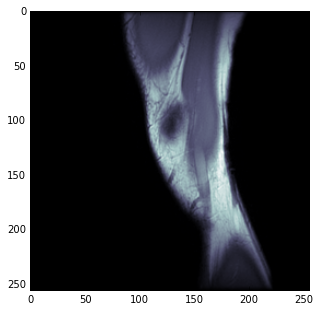

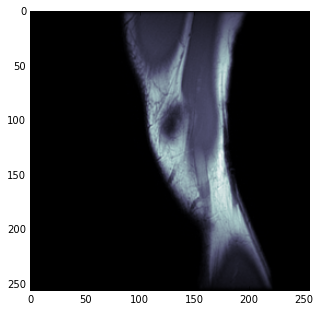

In [19]:
slice = 0

plt.figure(figsize=(5,5))
plt.imshow(t2Array[slice,:,:], cmap='bone')

plt.figure(figsize=(5,5))
plt.imshow(t2Array[slice+1,:,:], cmap='bone')

##### Turn the 192X256X256 array into 24x256x256x8. 

In [22]:
numberEchos = 8
fourDimageShape = [t2Array.shape[0]/numberEchos, numberEchos, t2Array.shape[1], t2Array.shape[2]]
fourDt2 = t2Array.flatten()
fourDt2 = numpy.reshape(fourDt2, fourDimageShape, 'C')
fourDt2 = numpy.transpose(fourDt2, (0,2,3,1))
print(fourDt2.shape)

(24, 256, 256, 8)


Just printing the 8 echos one after the other for an individual slice

If you look at the colorbar on the side you will notice that the scale is decreasing as we go down through the echos. This makes sense and indicates that the echos are in the right order

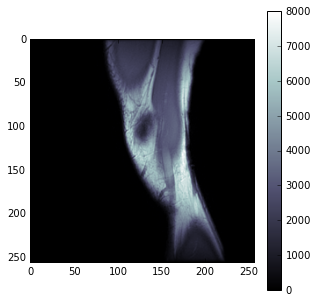

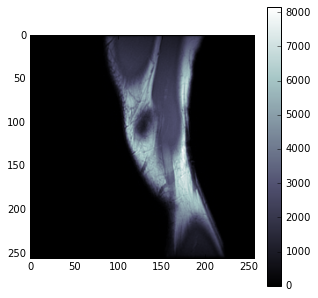

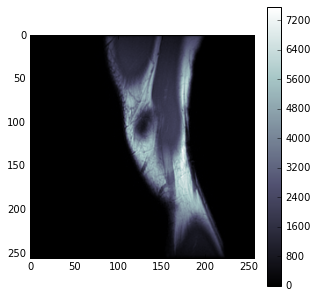

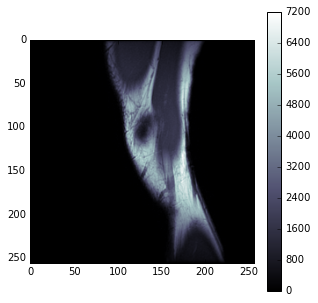

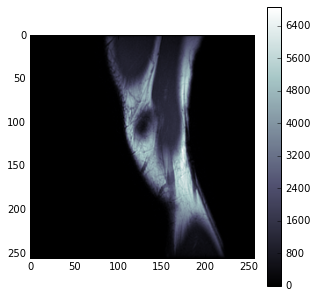

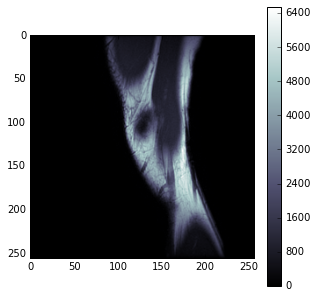

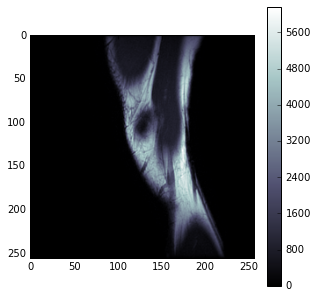

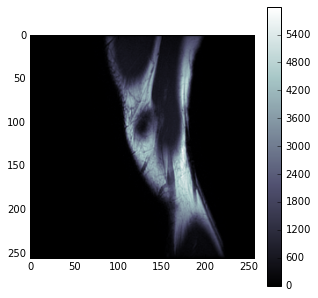

In [23]:
slice = 0
for echo in range(8):  
    plt.figure(figsize=(5,5))
    plt.imshow(fourDt2[slice,:,:, echo], cmap='bone')
    plt.colorbar()

#### Get the specfic echo times for fitting the T2 data

I added some code in here to get the spacing between slices at the same time. 
# N.B. about spacing field

In [24]:
os.chdir(locationT2)
TEmetafield = '0018|0081'
spacingField = '0018|0088'
listT2Slices = glob.glob('*.dcm')
listOfEchoTimes = numpy.zeros(len(listT2Slices))
sliceSpacing = numpy.zeros(len(listT2Slices))
index = 0
for t2Slice in listT2Slices:
    image = sitk.ReadImage(t2Slice)
    listOfEchoTimes[index] = image.GetMetaData(TEmetafield)
    sliceSpacing[index] = image.GetMetaData(spacingField)
    index +=1
TEs = numpy.sort(numpy.unique(listOfEchoTimes))
t2Spacing = numpy.unique(sliceSpacing)
if len(t2Spacing) != 1:
    print(1000*'*' + 1000 *' ' +'MAJOR ERROR.... DIFFERENT SLICES/ECHOS HAVE DIFFERENT SLICE SPACING!!!!!!!!!' + 1000 *' ' +1000*'*' )

In [25]:
def calculateT2map(t2Data, TEs, t2Cutoff=100, r2Cutoff=0.7):
    fourDSize = t2Data.shape #Shape of the multidimensional array

    #log transform the T2 data to be able to do a linear least squares estimate. 
    t2Log = numpy.log(t2Data)
    noPixels = fourDSize[0] * fourDSize[1] * fourDSize[2] #number of pixels in the entire 3D MRI

    #get number of echoes and create the array needed to do the least squares estimate. 
    noEchoes = len(TEs)
    regressTE = numpy.matrix([numpy.ones(noEchoes), TEs]).T
    '''
    Calcualte beta coefficients from: beta =(X.T * X).I * X.T * Y
    As can be seen from the above equation, most of the math can be done from just the X(TE) data before multiplying the Y(SI) as the last step. 
    Because TEs are constant across pixels, this math can be done once and then be multiplied by each respective set of Y(SIs).
    '''
    regressTE = numpy.matrix(regressTE) # These are to prepare the Echoes... or the X variable from the above equation.
    regressPartOne = (regressTE.T*regressTE).I *regressTE.T #this is that part of the equation that can be done without SI (Y-variable).
    '''
    We now prepare the dependent variable. Turn the 3D volume for each TE into a single-dimension and concatenate. So we end up with a matrix that is 2 dimensions. 
    The first dimension is the number of echoes and the second dimension is the number of pixels in the entire MRI. 
    '''
    dependentVariable = numpy.empty([noEchoes, noPixels])
    for echo in range(noEchoes):
        dependentVariable[echo,:] = t2Log[:,:,:,echo].flatten()
    dependentVariable = numpy.matrix(dependentVariable)

    regressionResult = numpy.dot(regressPartOne, dependentVariable)# produces a 2xn matrix with row 1 = intercept, and row 2 = T2 fit or 1/T2. 
    t2Values = numpy.asarray(-1/regressionResult[1,:]) #these are the T2 values - still in a single dimension
    pdValues = numpy.asarray(regressionResult[0,:]) # these are the PD values - still in single dimension - These are in log transformed Units
    pdValues = numpy.exp(pdValues)

    nanValues = numpy.where( ((numpy.isnan(t2Values)) | (numpy.isinf(t2Values)) )) #determines where we have NANs / Infinity
    t2Values[nanValues] = 0 #set nans = 0 
    outlierValues = numpy.where( ((t2Values>t2Cutoff) | (t2Values<0)) )  #Identified outliers based on the t2 cutoff. Take all T2 values that are between our upper cutoff determined in the GUI and 0. 0 is the lower-bound because this is the lowest value that makes logical sense, it shouldn't / cant be <0. 
    t2Values[outlierValues] = 0 #set outliers = 0


    '''
    Now we calculate the R2 for each pixel. We use the general notation that R2 = 1 - ssRes/ssTotal
    Where ssTotal = sum(yi-ymean)^2;
    ssRes = sum(ymeasured - ypredicted)^2
    '''
    determineR2For = numpy.where((t2Values[0,:] >0 )) #only calcualte R2 for non-zero numbers (outliers etc. removed)
    dvDoMath = numpy.squeeze(dependentVariable[:,determineR2For]) #only the Y (dependent) values that are not "outliers"
    #resultR2 = numpy.zeros(shape =(dvDoMath.shape[1]))
    r2WholeImage = numpy.zeros(shape=(t2Values.shape[1])) #pre-allocate Array that we will fill with R2 values later
    regressionCoefficientsCandidates = numpy.squeeze(regressionResult[:,determineR2For])

    ssTotalMean = numpy.mean(dvDoMath, axis=0) #calculate mean Log transfortmed SI for each pixel. 
    ssTotalDiff = dvDoMath-ssTotalMean #What is the difference between the SI of each pixel and the mean SI for that pixel
    ssTotalDiffSquared = numpy.square(ssTotalDiff) #Square the difference between the mean value and the actual SI
    ssTotal = numpy.sum(ssTotalDiffSquared, axis=0) #sum of squares total = sum of the squared differences. 

    intercept = regressionCoefficientsCandidates[0,:] #Get intercepts for only the pixels of interest. 
    slope = regressionCoefficientsCandidates[1,:] #Get the slopes for only the pixels of interest
    echoTime = numpy.zeros(shape=(dvDoMath.shape))
    for index in range(noEchoes):
        echoTime[index,:] = TEs[index] #creates an array that essentially tells the TE (independent variable) for every collected dependent variable (Y or SI). 
    slopeTimesEchoTime = numpy.multiply(echoTime, slope) 
    ssResPredicted = numpy.add(intercept, slopeTimesEchoTime)# Add intercept to the above portion of the equation and determine the predicted SI (Y) for every pixel. 
    ssResDiff = numpy.subtract(dvDoMath, ssResPredicted) #Difference between the predicted values and the actual values
    ssResDiffSquared = numpy.square(ssResDiff) #Squared Difference
    ssRes = numpy.sum(ssResDiffSquared, axis=0) #Sum of the squared differeences, or the sum of the squared residuals. 

    unexplainedVariance = numpy.divide(ssRes, ssTotal) # Unexplained variance is determined by ssRes/ssTotal. 
    r2 = numpy.subtract(1, unexplainedVariance) #R2 is just 1- the unexplained variance. 

    #Now we place the calcualted r2 values back in those pixels where we wanted to determine it... i.e. those with an "acceptable" fit as chosen in the GUI
    r2WholeImage[determineR2For] = r2

    poorfit = numpy.where(r2WholeImage<r2Cutoff)
    t2Values = numpy.squeeze(t2Values)
    t2Values[poorfit] = 0 #setthe locations that had poor fit to be equal to 0.

    t2Map = numpy.reshape(t2Values, fourDSize[0:3])
    pdMap = numpy.reshape(pdValues, fourDSize[0:3])
    r2Map = numpy.reshape(r2WholeImage, fourDSize[0:3])
    
    return (t2Map, pdMap, r2Map)

In [26]:
t2Map = calculateT2map(fourDt2, TEs)[0]
#I've indexed this using [0] so that it only returns the t2Map... but this can be used to get the other maps too

/Users/gattia/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:5: RuntimeWarning: divide by zero encountered in log
/Users/gattia/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:28: RuntimeWarning: divide by zero encountered in divide


### Print out and view the resulting T2map

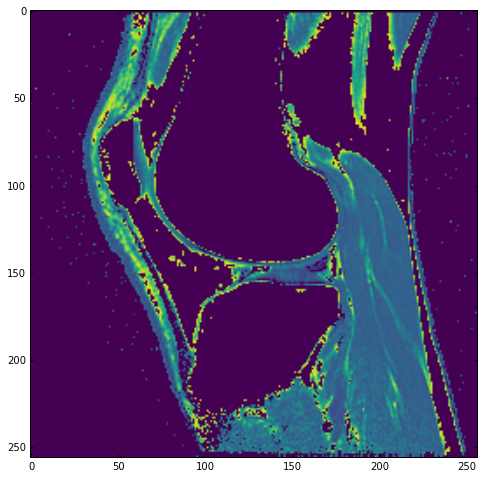

In [27]:
slice = 16
plt.figure(figsize=(8,8))
plt.imshow(t2Map[slice,:,:], cmap='viridis')

The T2map is now in the correct shape that we will want to turn the FSPGR/Segmentations into. So, we need to turn it into an "image" to be able to proceed down that path. So... we are continuing with Step 3

# Step 3 - continued

In [28]:
t2MapImage = sitk.GetImageFromArray(t2Map)
t2MapImage.SetOrigin(t2Image.GetOrigin())
t2MapImageSpacing = [t2Image.GetSpacing()[0],t2Image.GetSpacing()[1], t2Spacing[0]]
t2MapImage.SetSpacing(t2MapImageSpacing)
t2MapImage.SetDirection(t2Image.GetDirection())

In [29]:
t2MapImage.GetSpacing()

(0.625, 0.625, 4.0)

In [30]:
downsampledFSPGR = resizeImage(fspgrImage, t2MapImage, interpolatorType=sitk.sitkBSpline)
downsampledSegmentation = resizeImage(newSegmentationImage, t2MapImage)

In [31]:
print('FSPGR Spacing:     ' + str(downsampledFSPGR.GetSpacing()))
print('New Seg Spacing:   ' + str(downsampledSegmentation.GetSpacing()))
print('T2 Spacing:        ' + str(t2MapImage.GetSpacing()))
print('FSPGR Origin:      ' + str(downsampledFSPGR.GetOrigin()))
print('New Seg Origin:    ' + str(downsampledSegmentation.GetOrigin()))
print('T2 Origin:         ' + str(t2MapImage.GetOrigin()))
print('FSPGR Shape:       ' + str(downsampledFSPGR.GetSize()))
print('New Seg Shape:     ' + str(downsampledSegmentation.GetSize()))
print('T2 Shape:          ' + str(t2MapImage.GetSize()))

FSPGR Spacing:     (0.625, 0.625, 3.9165926625331244)
New Seg Spacing:   (0.625, 0.625, 3.9165926625331244)
T2 Spacing:        (0.625, 0.625, 4.0)
FSPGR Origin:      (-28.51580047607422, -103.57499694824219, 56.35459899902344)
New Seg Origin:    (-28.51580047607422, -103.57499694824219, 56.35459899902344)
T2 Origin:         (-29.036399841308594, -103.42900085449219, 56.275699615478516)
FSPGR Shape:       (256, 256, 24)
New Seg Shape:     (256, 256, 24)
T2 Shape:          (256, 256, 24)


In [32]:
downsampledSegArray = sitk.GetArrayFromImage(downsampledSegmentation)
downsampledFSPGRArray = sitk.GetArrayFromImage(downsampledFSPGR)

### Overlaying Segmentation on T2Map
In the printed out results below you can see that the segmentation aligns well with the T2map for the first few slices. But, then the images start to diverge more and more as you scroll through the slices. I assume this has to do with the fact(s):

1. The FSPGR/Seg spacing above (3.917mm) is slighly different from the actuam MRI spacing for the T2 (4mm). 
2. This is being propogated/gets worse as you move across the knee. 

The first fix will be to change the resampler to using the spacing as opposed to the image size to resample images. I have used the image size in the past because the goal is to make images the same number of pixels in each direction for my neural net. That's not what we are doing here :). 

After I "fixed" the resampler to use the pixel spacing and not the image size things were still off. So, I went about a different path. 

First, the actual array of pixels is called "pixel space" and the location of those pixels in the world is called "physical space". So, what I did was extracted the physical space location of the 8 corners of the t2map. With the physical space location of these corners I then determined what the coinciding pixel space of the FSPGR image would be for those physical locations. For this example the beginning pixels just happened to be at or greater than 0. However, the "other-side" of the image was beyond the dimensions of the original image. I created a small function to make the image bigger so that we could sample beyond the edges of the fspgr image. What I did should work for this image.... but if the smallest pixel locations are negative then the code will have to be updated. 

#### The below printout shows that for the last few slices there is a misalignment between the segmentation and T2map

/Users/gattia/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


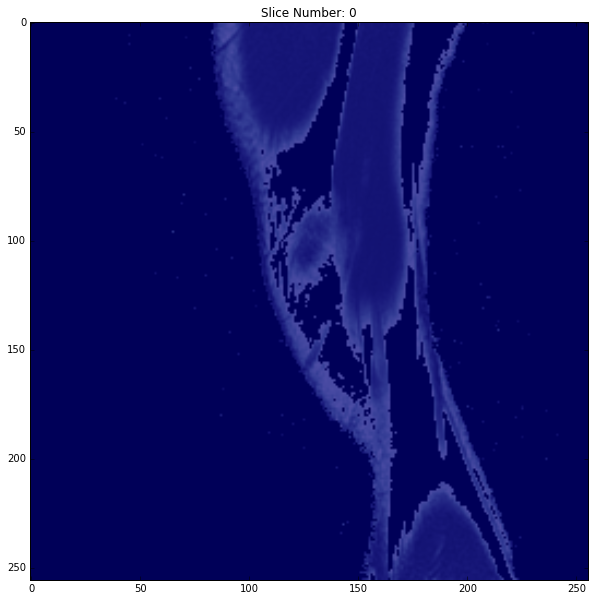

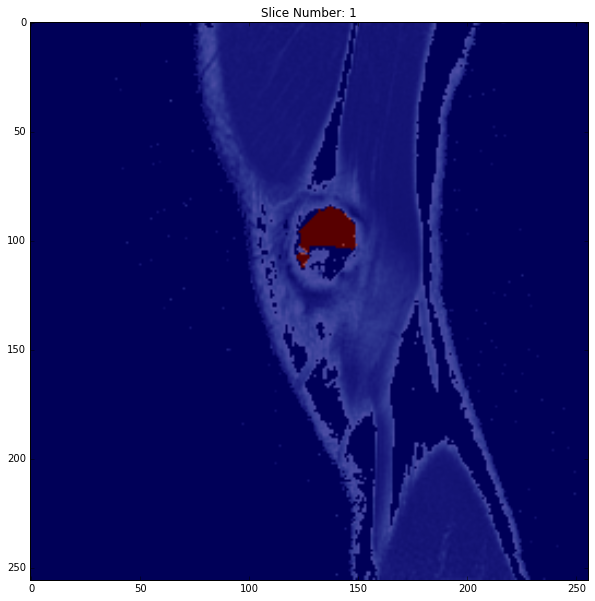

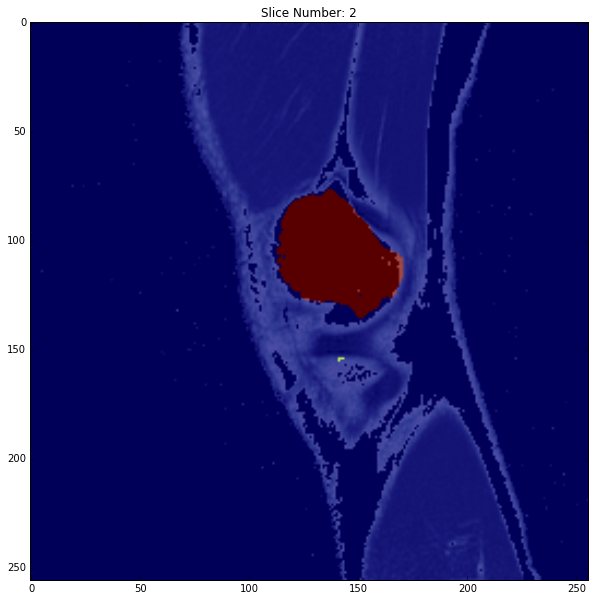

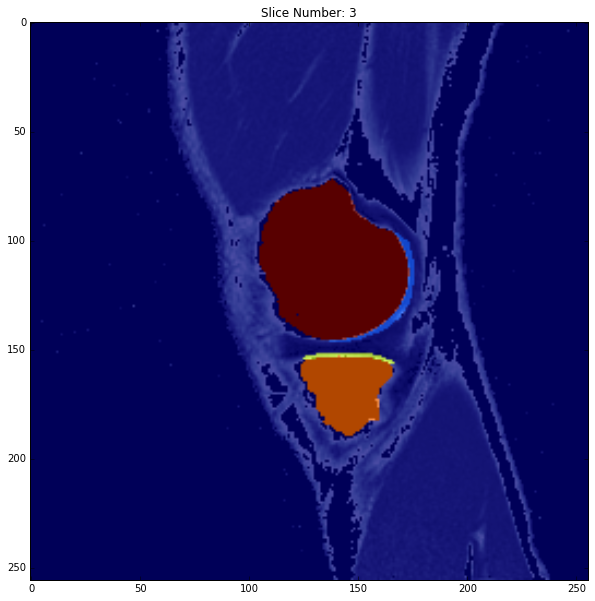

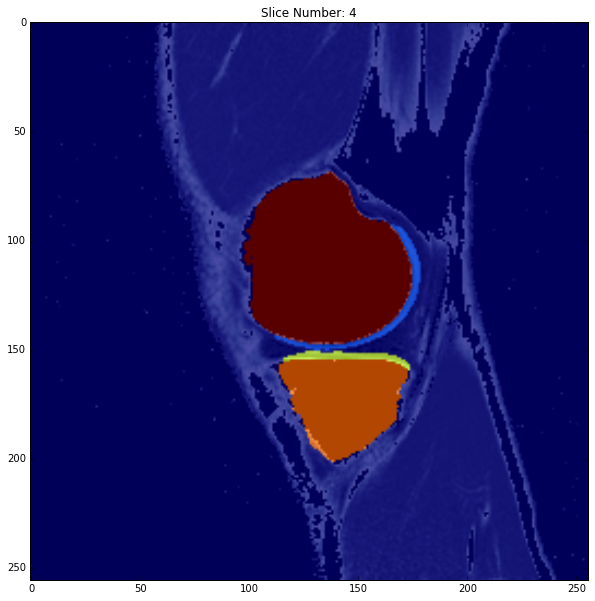

...

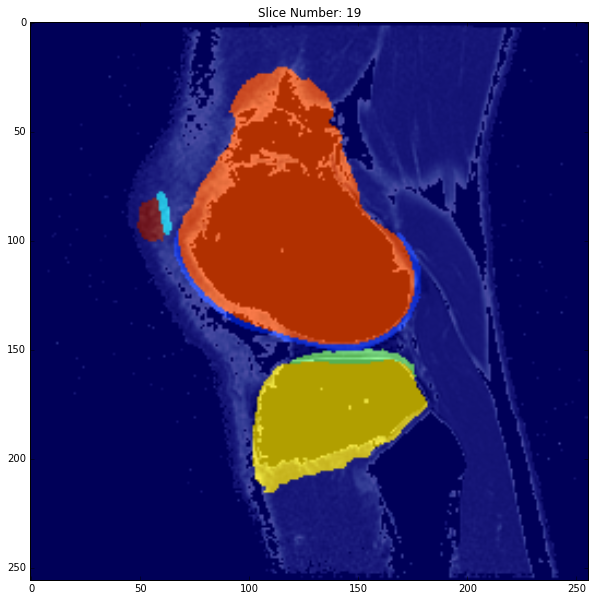

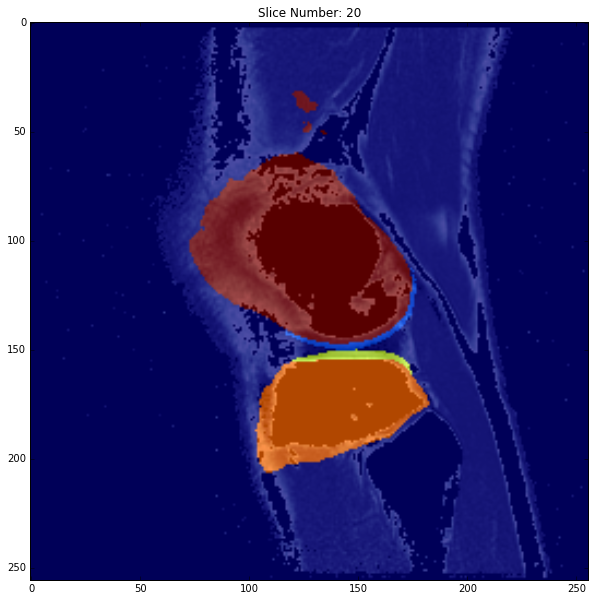

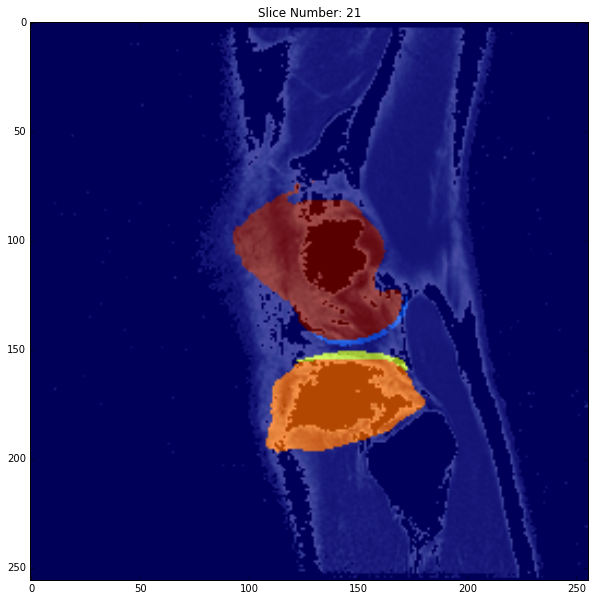

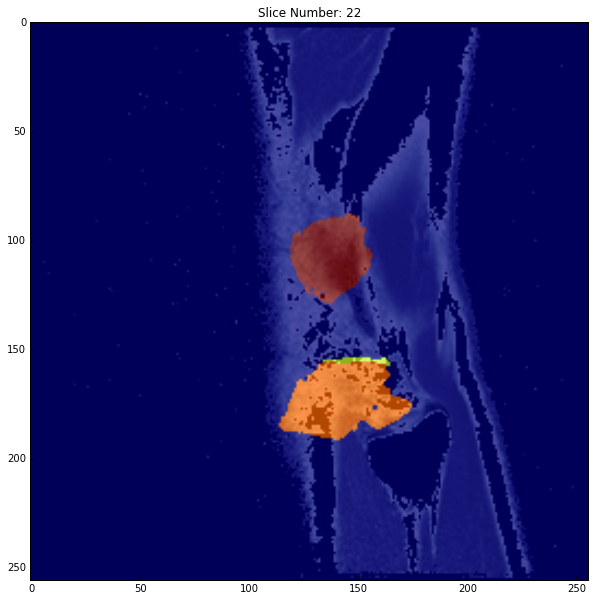

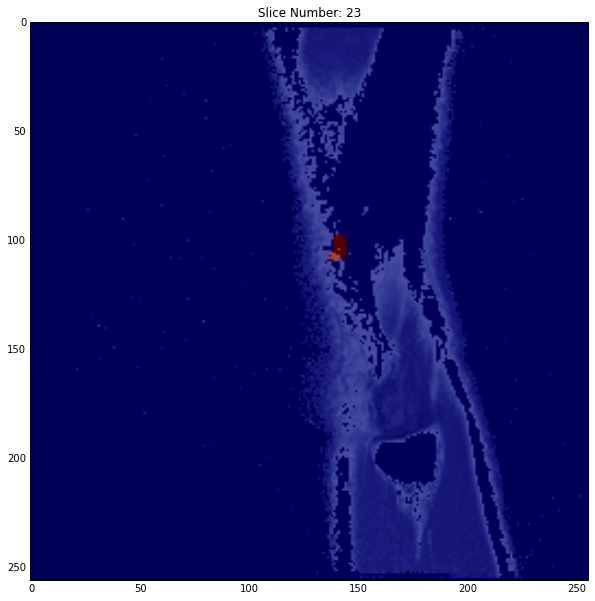

In [33]:
for slice in range(t2Map.shape[0]):
    plt.figure(figsize=(10,10))
    plt.title('Slice Number: ' + str(slice))
    plt.imshow(t2Map[slice,:,:], cmap='bone')
    plt.imshow(downsampledSegArray[slice,:,:], alpha=0.7)

So, what we need is:
    * A. We need to "resize" the FSPGR/Segmentation images in their original resolution to cover the same space as the T2map. 
    * B. We then need a new resizeImage function that resizes based on the pixels sizes and not on the outside dimensions of the image. 
    * C. Profit! 

I'm still going to do a bit of playing around... this is probably not the final method. Watch below to see notes and what I land on.

#### First
Get the physcial corners from the T2map image and then fine the coinciding pixel corners for the FSPGR (same as segmentation)

In [34]:
corners = numpy.asarray([[0,0,0],[0,256,0],[256,256,0],[256,0,0],[0,0,24],[0,256,24],[256,256,24],[256,0,24]], dtype=numpy.float)
physicalCorners = numpy.zeros_like(corners)
fspgrCorners = numpy.zeros_like(corners)
for corner in range(corners.shape[0]):
    physicalCorners[corner,:] = t2MapImage.TransformContinuousIndexToPhysicalPoint(corners[corner,:])
    fspgrCorners[corner,:] = fspgrImage.TransformPhysicalPointToContinuousIndex(physicalCorners[corner,:])


In [35]:
print(physicalCorners)
print(fspgrCorners)

[[ -29.03639984 -103.42900085   56.27569962]
 [ -52.19992925 -100.38739962 -102.00948468]
 [ -55.69341806   59.53429504  -98.42519751]
 [ -32.52988866   56.4926938    59.85998678]
 [-124.00191315 -105.81397184   70.12716866]
 [-147.16544256 -102.7723706   -88.15801564]
 [-150.65893138   57.14932405  -84.57372847]
 [-127.49540197   54.10772282   73.71145582]]
[[  4.97677055e-01   4.99831681e-01   4.99987751e-01]
 [  4.97677055e-01   5.12499832e+02   4.99987751e-01]
 [  5.12497677e+02   5.12499832e+02   4.99987751e-01]
 [  5.12497677e+02   4.99831681e-01   4.99987751e-01]
 [  4.97677055e-01   4.99831681e-01   9.65018017e+01]
 [  4.97677055e-01   5.12499832e+02   9.65018017e+01]
 [  5.12497677e+02   5.12499832e+02   9.65018017e+01]
 [  5.12497677e+02   4.99831681e-01   9.65018017e+01]]


Round and make the voxel indexing be integers

In [36]:
fspgrCorners_int = numpy.round(fspgrCorners).astype(numpy.int)
print(fspgrCorners_int)

[[  0   0   0]
 [  0 512   0]
 [512 512   0]
 [512   0   0]
 [  0   0  97]
 [  0 512  97]
 [512 512  97]
 [512   0  97]]


The below code does 2 things.
1. It takes in the "corners" of the data and determines the shape that the FSPGR "should" be to match the T2map. 
2. It uses those corners to resample the FSPGR image to include that extra space (or less space if needed. 

**N.B.** For step 2, this works as is because the minimum values for x/y/z happen to be 0,0,0. The function would need to change if this wasn't the case anymore.

In [37]:
def getMinMax(array):
    minimum = numpy.min(array)
    maximum = numpy.max(array)
    return (minimum, maximum)
    
def getImageShapeFromCorners(corners):
    minX, maxX = getMinMax(corners[:,0])
    minY, maxY = getMinMax(corners[:,1])
    minZ, maxZ = getMinMax(corners[:,2])
    imageShape = [maxX-minX+1, maxY-minY+1, maxZ-minZ+1]
    return imageShape
    
def resampleImageSpace(image, corners, interpolatorType=sitk.sitkNearestNeighbor):
    spacing = numpy.asarray(image.GetSpacing(), dtype=numpy.float)
    size = numpy.asarray(image.GetSize(), dtype=numpy.float)
    newSize = getImageShapeFromCorners(corners)
    resampler = sitk.ResampleImageFilter()
    resampler.SetReferenceImage(image)
    resampler.SetOutputSpacing(spacing)
    resampler.SetSize(newSize)
    resampler.SetInterpolator(interpolatorType)
    resampledImage = resampler.Execute(image)
    return(resampledImage)

In [38]:
def resizeImage_spacing(image, targetImage, interpolatorType=sitk.sitkNearestNeighbor):
    spacing = numpy.asarray(image.GetSpacing(), dtype=numpy.float)
    size = numpy.asarray(image.GetSize(), dtype=numpy.float)
    outputSizeSitk = numpy.asarray(targetImage.GetSize())
    outputSpacingSitk = numpy.asarray(targetImage.GetSpacing())
    changeSize = numpy.asarray(outputSizeSitk, dtype=numpy.float)/size
#     changeSpacing = numpy.asarray((spacing/changeSize), dtype=numpy.float)
    resampler = sitk.ResampleImageFilter()
    resampler.SetReferenceImage(image)
    resampler.SetOutputSpacing(outputSpacingSitk)
    resampler.SetSize(outputSizeSitk)
    resampler.SetInterpolator(interpolatorType)
    resampledImage = resampler.Execute(image)
    return(resampledImage)

Apply the resample image space to the segmentation. Then I used two different functions to do the resizing. I used the original function as well as the new function that I wrote that uses the pixel spacing. I then printed out all three results (original segmentation, segmentation that resized using pixel sizes, segmentation that resized using image dimensions). This was we can compare the three and decide which appears to be best. 

**N.B.** This comparison used the original T2 "images" and not the "map" as the image below the segmentations. I thought this was better for visualizing how good the alignment was. 

In [39]:
newSegmentation = resampleImageSpace(newSegmentationImage, fspgrCorners_int)
newSegmentation_downsampled_original_downsampler = resizeImage(newSegmentation, t2MapImage)
newSegmentation_downsampled_new_pixel_shape_downsampler = resizeImage_spacing(newSegmentation, t2MapImage)
newSeg_array_orig_downsampler = sitk.GetArrayFromImage(newSegmentation_downsampled_original_downsampler)
newSeg_array_new_pixel_downsampler = sitk.GetArrayFromImage(newSegmentation_downsampled_new_pixel_shape_downsampler)

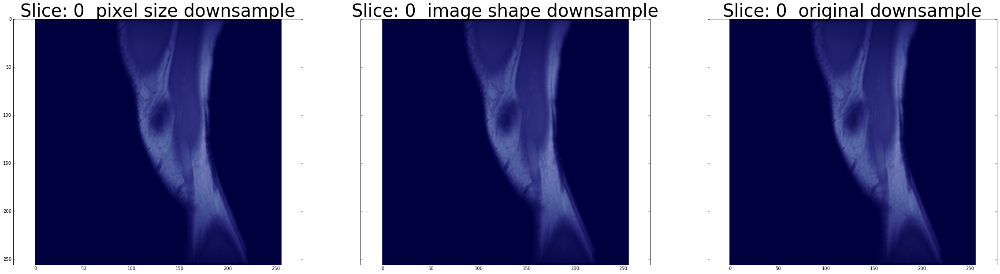

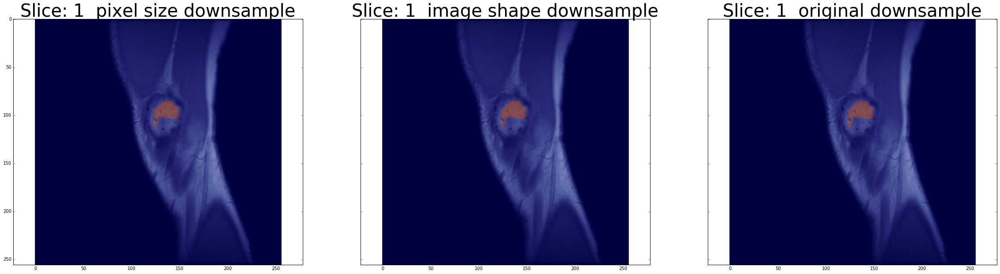

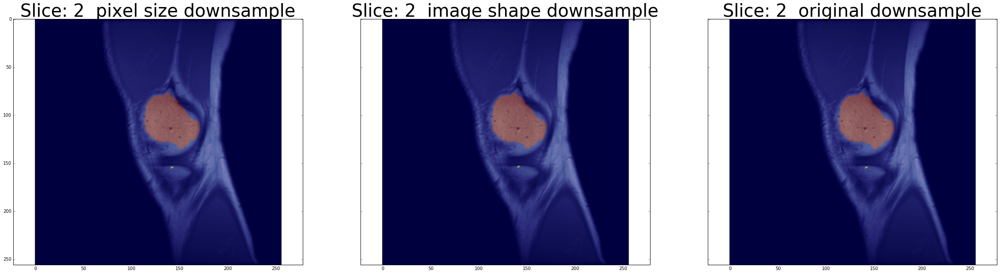

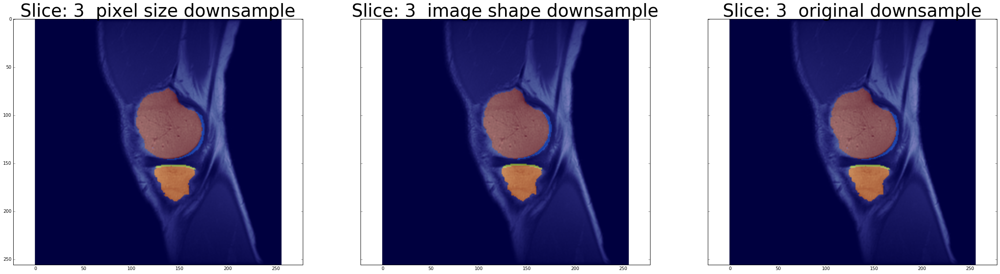

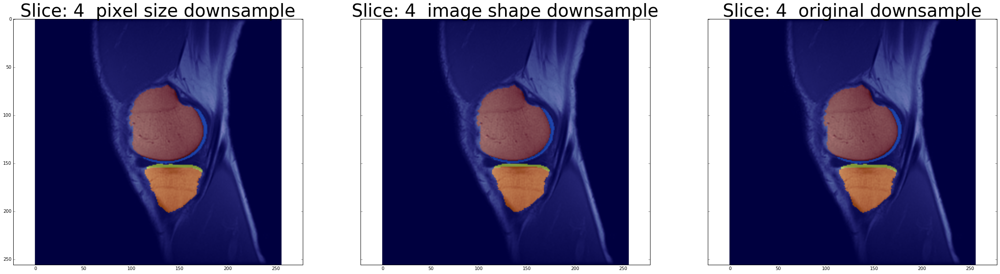

...

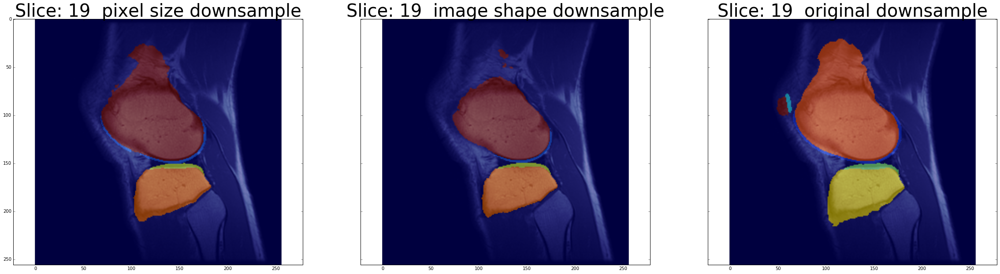

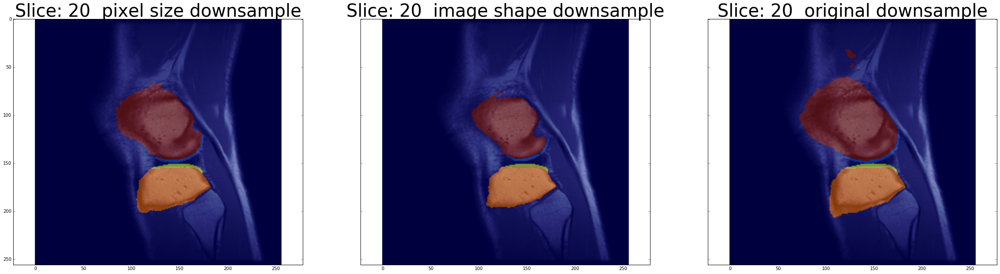

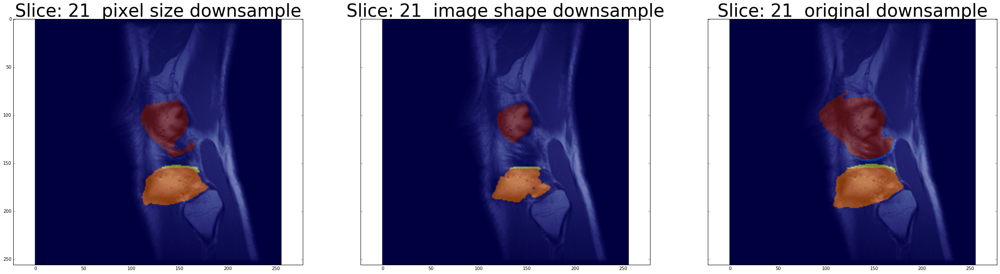

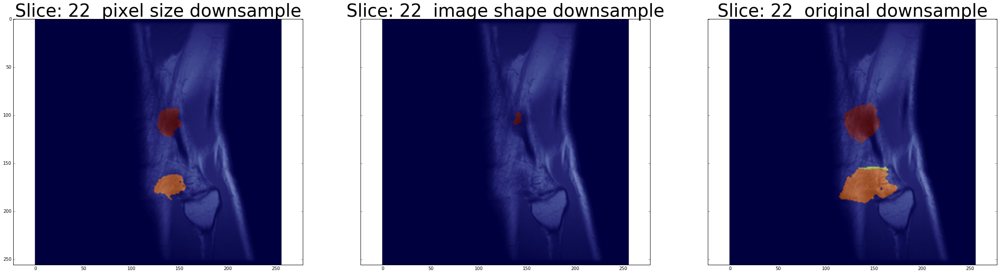

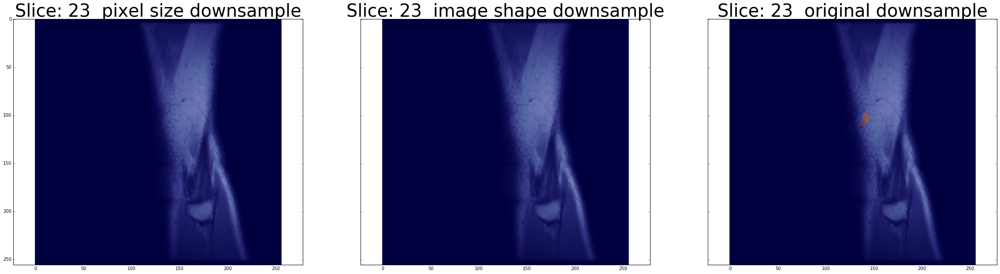

In [40]:
for slice in range(t2Map.shape[0]):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharey=True, figsize=(40,10))
    ax1.imshow(fourDt2[slice,:,:,0], cmap='bone')
    ax1.imshow(newSeg_array_new_pixel_downsampler[slice,:,:], alpha=0.5)
    ax1.set_title('Slice: ' + str(slice) + '  pixel size downsample', fontsize=40)
    ax2.imshow(fourDt2[slice,:,:,0], cmap='bone')
    ax2.imshow(newSeg_array_orig_downsampler[slice,:,:], alpha=0.5)
    ax2.set_title('Slice: ' + str(slice) + '  image shape downsample', fontsize=40)
    ax3.imshow(fourDt2[slice,:,:,0], cmap='bone')
    ax3.imshow(downsampledSegArray[slice,:,:], alpha=0.5)
    ax3.set_title('Slice: ' + str(slice) + '  original downsample', fontsize=40)

From all of those printouts I think that the middle set of segmentations worked out the best. Funny... that happens to be the one that uses the original resizing tool. Not what I expected. But in hindsight does make some sense.



Just making the names of things a bit easier now that I've chosen a single image resizing method

In [41]:
newSegmentation = resampleImageSpace(newSegmentationImage, fspgrCorners_int)
downsampledSegImage = resizeImage_spacing(newSegmentation, t2MapImage)
downsampledSegArray = sitk.GetArrayFromImage(downsampledSegImage)

# Step 5 ... finally
First, I'm going to print out one of the middle slices to see what the different segmentation regions are labelled as. Using the numbers for the tibia I will extract the tibial cartilage T2 data and do the manipulations to get it into a standard space.

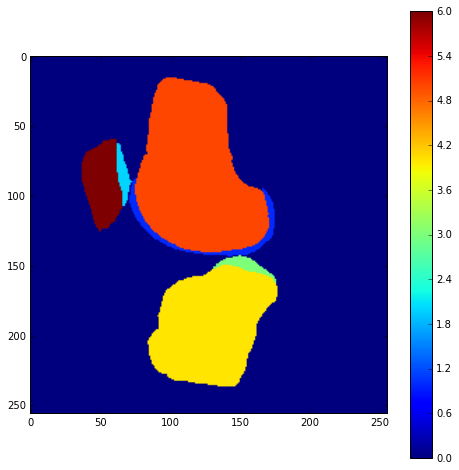

In [42]:
slice = 15
plt.figure(figsize=(8,8))
plt.imshow(downsampledSegArray[slice,:,:])
plt.colorbar()

**Tibial cartilage is #3. **

In [43]:
tibiaNumber = 3
locationTibialCartilage = numpy.where(downsampledSegArray==tibiaNumber)
minX, maxX = getMinMax(locationTibialCartilage[0])
minY, maxY = getMinMax(locationTibialCartilage[1])
minZ, maxZ = getMinMax(locationTibialCartilage[2])
tibialCartilageSegmentation = numpy.zeros([maxX-minX, maxY-minY, maxZ-minZ])
tibialCartilageSegmentation[:] = downsampledSegArray[minX:maxX, minY:maxY, minZ:maxZ]
tibialCartilageT2 = numpy.zeros([maxX-minX, maxY-minY, maxZ-minZ])
tibialCartilageT2[:] = t2Map[minX:maxX, minY:maxY, minZ:maxZ]

Take a quick peak at what this looks like

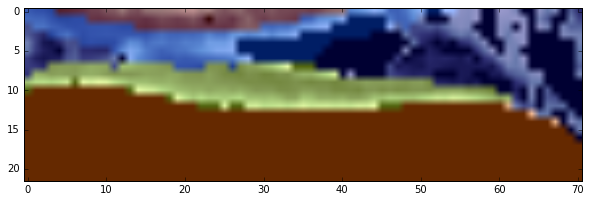

In [44]:
slice = 6
plt.figure(figsize=(10,10))
plt.imshow(tibialCartilageT2[slice,:,:], cmap='bone')
plt.imshow(tibialCartilageSegmentation[slice,:,:], alpha=0.4)


# Step 6 Mean / SD

In [45]:
backgroundCartilageImages = numpy.where(tibialCartilageSegmentation!=tibiaNumber)
tibialCartilageT2[backgroundCartilageImages]=numpy.nan

Now let's plot the same thing as above but with Nans wherever the segmentation is not equal to the tibial cartilage number/index

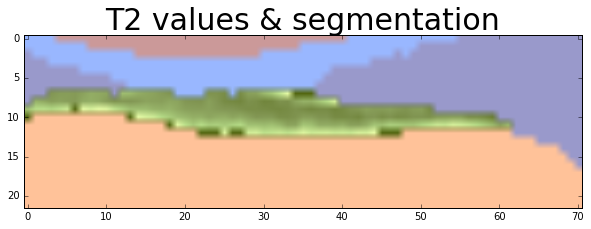

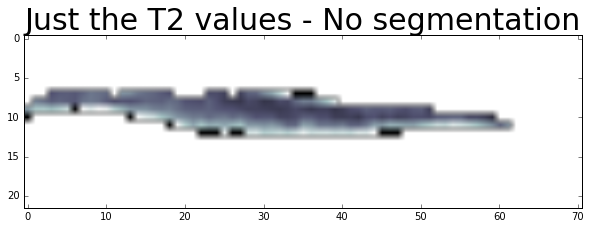

In [46]:
slice = 6
plt.figure(figsize=(10,10))
plt.imshow(tibialCartilageT2[slice,:,:], cmap='bone')
plt.imshow(tibialCartilageSegmentation[slice,:,:], alpha=0.4)
plt.title('T2 values & segmentation', fontsize=30)


plt.figure(figsize=(10,10))
plt.imshow(tibialCartilageT2[slice,:,:], cmap='bone')
plt.title('Just the T2 values - No segmentation', fontsize=30)


In [47]:
whereT2zero = numpy.where(tibialCartilageT2==0)
tibialCartilageT2[whereT2zero]=numpy.nan

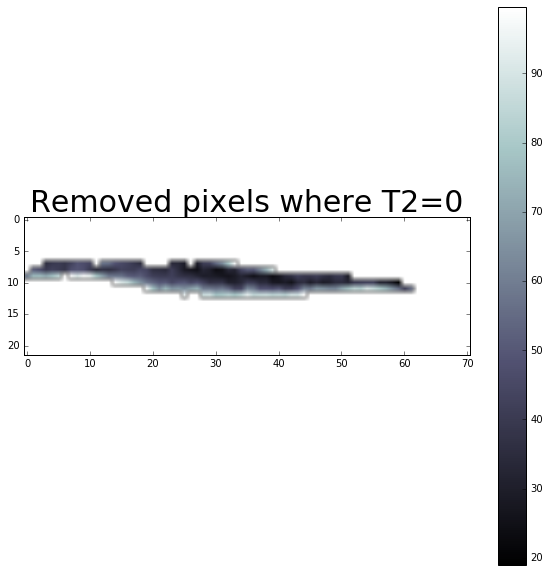

In [49]:
slice = 6
plt.figure(figsize=(10,10))
plt.imshow(tibialCartilageT2[slice,:,:], cmap='bone')
plt.title('Removed pixels where T2=0', fontsize=30)
plt.colorbar()

### Now we flatten

In [50]:
tibialT2Mean = numpy.nanmean(tibialCartilageT2,axis=1)
tibialT2SD = numpy.nanstd(tibialCartilageT2,axis=1)

/Users/gattia/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:1: RuntimeWarning: Mean of empty slice
  if __name__ == '__main__':
/Users/gattia/anaconda2/lib/python2.7/site-packages/numpy/lib/nanfunctions.py:1427: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)


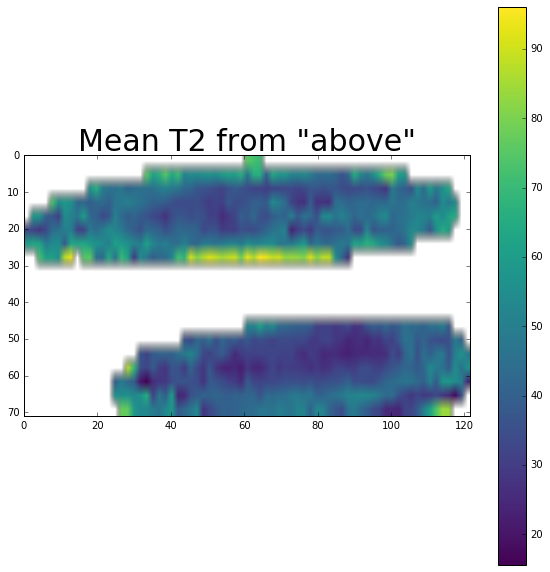

In [51]:
plt.figure(figsize=(10,10))
plt.imshow(tibialT2Mean, cmap='viridis', extent=[0,(4/0.625)*tibialT2Mean.shape[0],tibialT2Mean.shape[1],0])
#The extent thing above was used inorder to make the image appear to be roughly the right size/shape
plt.title('Mean T2 from "above"', fontsize=30)
plt.colorbar()

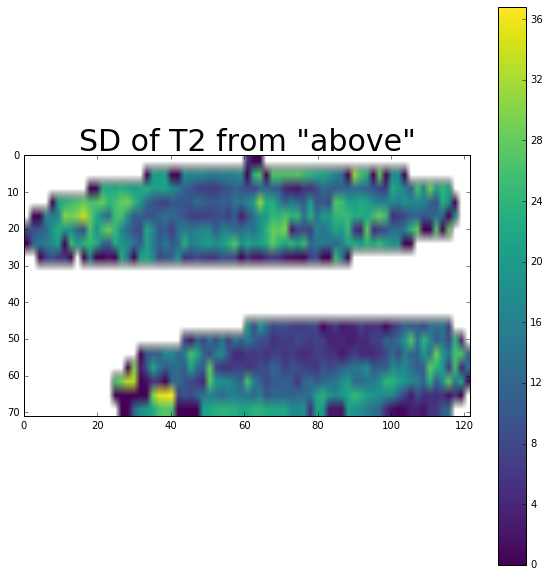

In [52]:
plt.figure(figsize=(10,10))
plt.imshow(tibialT2SD, cmap='viridis', extent=[0,(4/0.625)*tibialT2Mean.shape[0],tibialT2Mean.shape[1],0])
plt.title('SD of T2 from "above"', fontsize=30)
plt.colorbar()

# Step 7 -> need to do this for multiple image sets to continue
So, the SD map above is kinda useless. We really only want to use the mean map. 

In my mind, the next step is to import all participant and determine the average shape of this view. I would then warp everyone to be a multiple of this shape (sizing up or down as required). We can then combine many peoples mean maps together to get a global mean and a global sd. Those maps can then be used to do statistics. 

My suggestion would be to make all of the steps above that aren't functions into functions and then combine all of the individual functions into one big function that can be run on each individual image. This was you can easily create the mean maps for each participant and then do the comparisons as needed. 

Also, this is using all of the tibial cartilage in one go. But if the raw segmentation is imported instead and the medial/lateral are differentiated I think that the comparisons between people will be much better. Because as you can see the medial/lateral are lined up oddly with respect to one another and I expect that each participant will have slight deviations for this. 

## Ta-da!